In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice')
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')
        plt.title(f'Reconstructed {title} Slice')
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 256), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function = SSIMLoss(spatial_dims=3)
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)

    def training_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            for _ in range(3):  # Plot 3 random slices
                slice_idx = torch.randint(0, x.shape[2], (1,)).item()
                original_slice = x[0, 0, slice_idx, :, :].detach().cpu().numpy()
                reconstruction_slice = x_hat[0, 0, slice_idx, :, :].detach().cpu().numpy()
                self.slice_plotter.plot_slices(original_slice, reconstruction_slice, 'Train')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            for _ in range(3):  # Plot 3 random slices
                slice_idx = torch.randint(0, x.shape[2], (1,)).item()
                original_slice = x[0, 0, slice_idx, :, :].detach().cpu().numpy()
                reconstruction_slice = x_hat[0, 0, slice_idx, :, :].detach().cpu().numpy()
                self.slice_plotter.plot_slices(original_slice, reconstruction_slice, 'Val')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars('AE SSIM Job 1 Loss', {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='AE_SSIM{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc, transform=transform, num_workers=0)
val_dataset   = CacheDataset(val_dataset_uc,   transform=transform, num_workers=0)

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True,  num_workers=2)
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False, num_workers=2)

trainer = pl.Trainer(
    max_epochs=1500,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:10<02:56, 10.41s/it]

Loading dataset:  11%|█         | 2/18 [00:28<04:02, 15.13s/it]

Loading dataset:  17%|█▋        | 3/18 [00:39<03:13, 12.90s/it]

Loading dataset:  22%|██▏       | 4/18 [00:47<02:36, 11.19s/it]

Loading dataset:  28%|██▊       | 5/18 [01:01<02:36, 12.06s/it]

Loading dataset:  33%|███▎      | 6/18 [01:13<02:26, 12.20s/it]

Loading dataset:  39%|███▉      | 7/18 [01:23<02:04, 11.35s/it]

Loading dataset:  44%|████▍     | 8/18 [01:36<01:59, 11.94s/it]

Loading dataset:  50%|█████     | 9/18 [01:50<01:51, 12.44s/it]

Loading dataset:  56%|█████▌    | 10/18 [02:00<01:34, 11.80s/it]

Loading dataset:  61%|██████    | 11/18 [02:07<01:12, 10.39s/it]

Loading dataset:  67%|██████▋   | 12/18 [02:27<01:19, 13.26s/it]

Loading dataset:  72%|███████▏  | 13/18 [02:38<01:03, 12.73s/it]

Loading dataset:  78%|███████▊  | 14/18 [02:48<00:46, 11.73s/it]

Loading dataset:  83%|████████▎ | 15/18 [03:17<00:50, 16.97s/it]

Loading dataset:  89%|████████▉ | 16/18 [03:35<00:34, 17.27s/it]

Loading dataset:  94%|█████████▍| 17/18 [03:58<00:18, 18.89s/it]

Loading dataset: 100%|██████████| 18/18 [04:20<00:00, 19.85s/it]

Loading dataset: 100%|██████████| 18/18 [04:20<00:00, 14.46s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:09<01:05,  9.30s/it]

Loading dataset:  25%|██▌       | 2/8 [00:27<01:28, 14.69s/it]

Loading dataset:  38%|███▊      | 3/8 [00:37<01:02, 12.52s/it]

Loading dataset:  50%|█████     | 4/8 [00:57<01:00, 15.24s/it]

Loading dataset:  62%|██████▎   | 5/8 [01:10<00:43, 14.60s/it]

Loading dataset:  75%|███████▌  | 6/8 [01:32<00:34, 17.16s/it]

Loading dataset:  88%|████████▊ | 7/8 [01:46<00:15, 15.93s/it]

Loading dataset: 100%|██████████| 8/8 [02:02<00:00, 16.06s/it]

Loading dataset: 100%|██████████| 8/8 [02:02<00:00, 15.30s/it]

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /old_Users/tgafrick/RA4/jobs/job5/Models exists and is not empty.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 6.5 M 
1 | loss_function | SSIMLoss    | 0     
----------------------------------------------
6.5 M     Trainable params
0         Non-trainable params
6.5 M     Total params
25.892    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

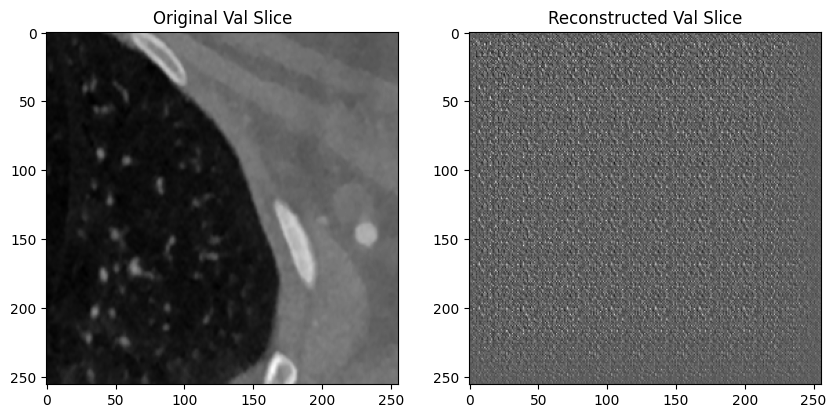

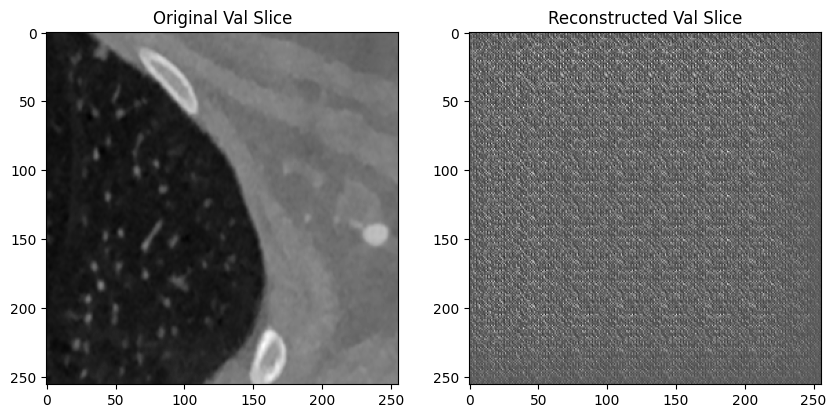

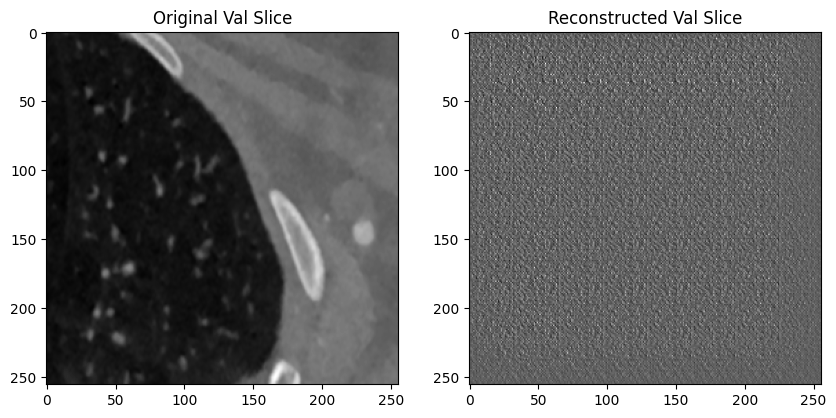

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

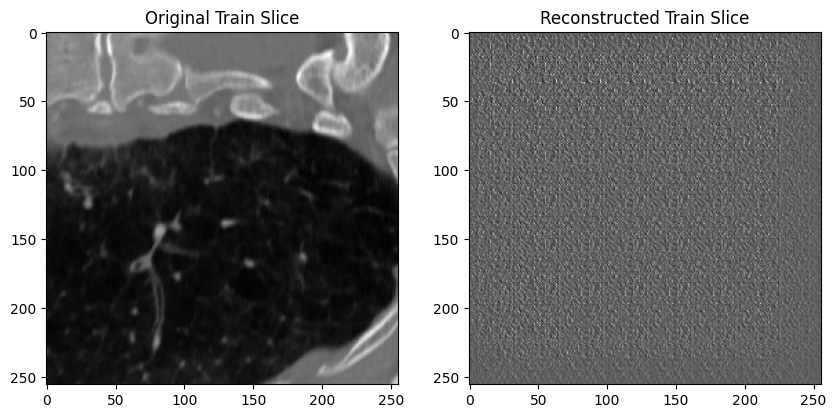

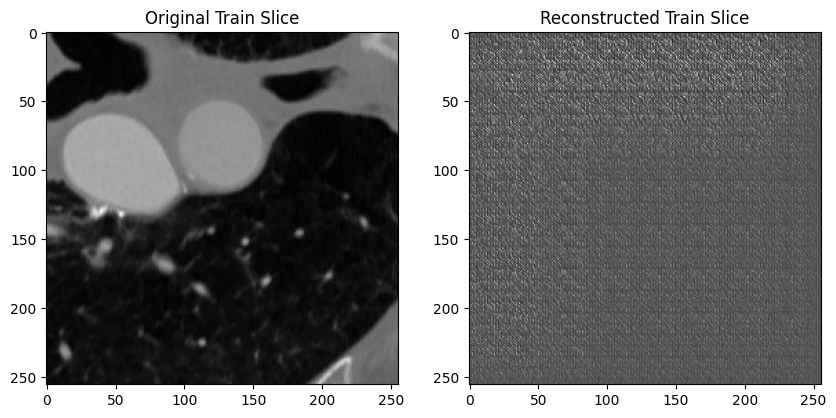

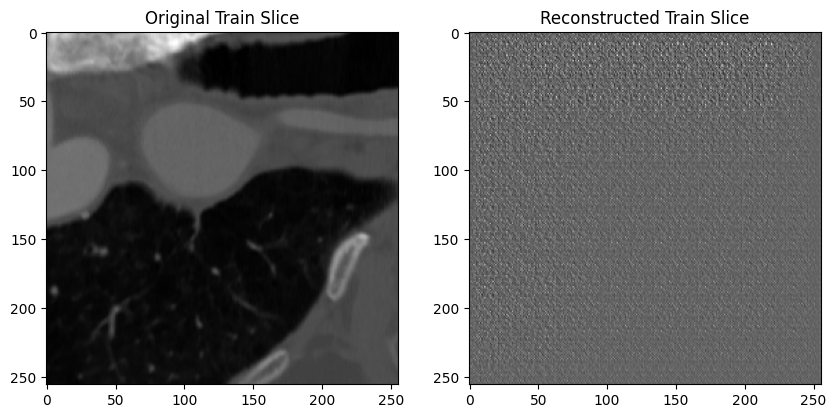

Validation: |          | 0/? [00:00<?, ?it/s]

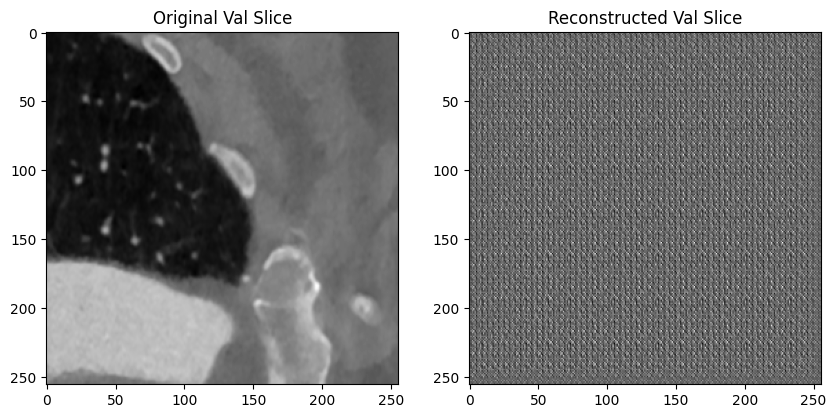

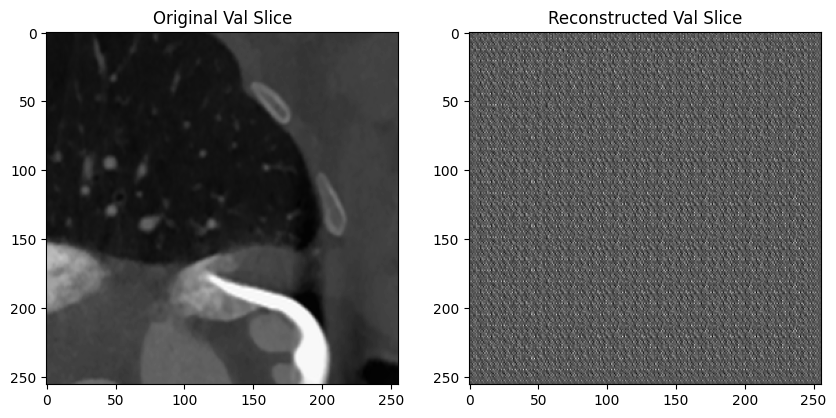

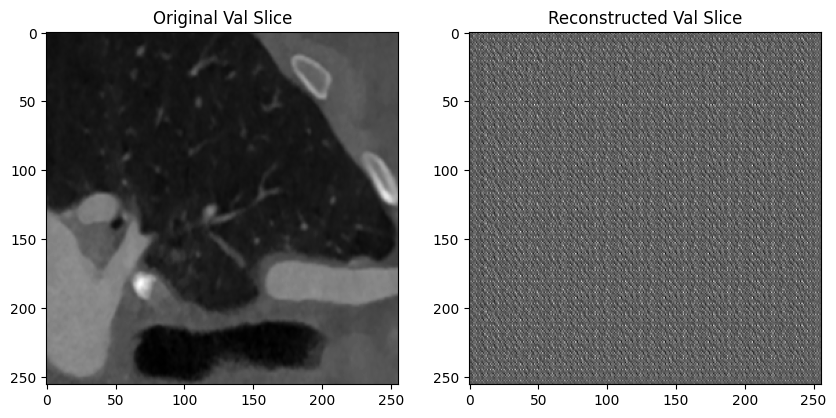

Time Spent 503.58
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 561.70
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 619.74
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 677.73
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 735.93
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 794.40
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 852.62
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 910.92
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 969.22
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1027.32
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1085.99
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1144.23
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1203.89
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1261.85
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1319.87
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1377.80
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1436.44
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1494.45
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1552.47
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1610.54
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1668.61
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1726.78
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1784.87
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1847.51
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1906.14
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1964.65
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2022.67
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2080.62
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2138.68
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2196.67
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2254.80
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2313.11
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2371.18
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2429.48
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2487.43
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2545.57
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2603.54
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2661.76
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2719.96
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2777.99
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2835.97
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2894.69
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2955.10
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3013.30
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3071.42
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3129.53
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3187.57
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3245.79
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3305.10
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3363.86
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3424.80
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3486.86
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3548.31
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3606.83
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3665.01
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3723.08
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3823.91
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3885.49
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3943.55
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4001.88
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4060.66
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4119.16
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4178.56
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4236.64
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4294.73
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4352.75
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4410.73
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4468.69
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4532.09
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4619.05
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4677.26
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4737.49
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4796.18
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4855.20
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4915.07
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4973.63
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5032.16
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5090.35
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5148.97
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5207.11
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5323.30
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5382.04
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5441.71
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5499.94
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5559.19
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5619.70
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5678.72
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5739.61
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5798.02
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5858.51
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5918.46
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5980.52
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6040.22
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6101.19
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6161.83
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6224.57
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6286.70
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6360.89
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6439.56
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6498.51
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6558.95
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6618.29
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6678.65
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6737.18
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6795.65
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6864.61
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6928.38
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6986.38
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7048.77
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7106.94
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7169.77
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7230.71
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7288.83
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7346.81
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7405.22
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7463.26
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7521.58
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7579.92
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7639.01
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7719.32
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7788.60
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7877.62
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7964.99
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8045.05
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8106.37
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8175.13
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8233.18
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8291.33
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8349.31
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8407.42
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8465.51
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8523.59
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8581.54
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8639.59
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8697.87
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8755.99
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8814.08
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8872.14
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8930.23
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8988.38
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9046.39
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9104.76
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9162.78
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9221.28
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9279.80
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9337.94
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9396.10
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9454.24
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9512.30
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9571.82
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9629.95
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9688.00
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9746.12
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9804.17
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9862.19
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9920.22
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9978.23
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10036.22
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10094.26
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10152.28
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10210.26
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10268.30
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10326.57
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10384.63
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10443.05
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10501.24
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10559.54
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10617.70
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10675.71
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10733.85
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10791.87
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10849.84
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10907.98
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10966.09
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11024.82
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11082.89
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11140.99
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11199.15
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11257.26
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11315.41
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11373.69
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11431.68
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11489.80
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11547.97
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11606.10
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11664.19
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11722.32
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11780.40
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11838.49
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11896.86
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11954.90
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12013.01
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12071.14
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12129.29
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12187.31
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12245.37
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12303.58
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12361.80
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12420.39
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12479.41
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12538.56
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12596.75
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12654.97
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12713.10
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12771.25
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12829.35
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12887.40
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12945.37
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13003.43
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13061.49
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13121.37
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13179.44
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13237.56
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13295.90
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13353.92
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13412.02
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13470.23
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13528.56
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13586.83
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13645.06
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13703.31
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13761.53
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13819.63
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13877.64
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13936.28
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13994.48
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14052.48
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14110.54
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14169.35
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14227.51
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14285.70
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14343.98
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14402.06
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14460.32
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14518.52
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14576.62
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14634.71
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14692.96
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14751.14
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14810.91
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14868.93
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14927.21
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14985.66
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15043.71
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15101.82
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15161.14
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15219.29
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15277.49
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15335.86
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15394.57
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15455.03
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15518.07
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15576.82
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15648.07
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15706.52
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15764.66
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15822.71
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15881.24
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15939.50
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15997.84
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16055.92
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16114.06
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16183.38
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16242.08
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16300.54
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16358.53
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16416.70
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16474.97
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16533.82
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16592.31
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16650.34
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16708.40
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16766.63
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16824.66
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16883.43
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16941.60
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17000.05
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17058.34
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17116.52
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17174.73
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17236.27
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17294.82
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17355.22
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17425.49
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17488.63
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17547.13
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17614.11
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17677.59
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17742.98
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17805.49
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17866.39
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17932.09
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17995.58
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18069.52
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18147.91
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18336.89
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18405.63
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18474.68
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18539.63
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18601.01
Epoch: 300


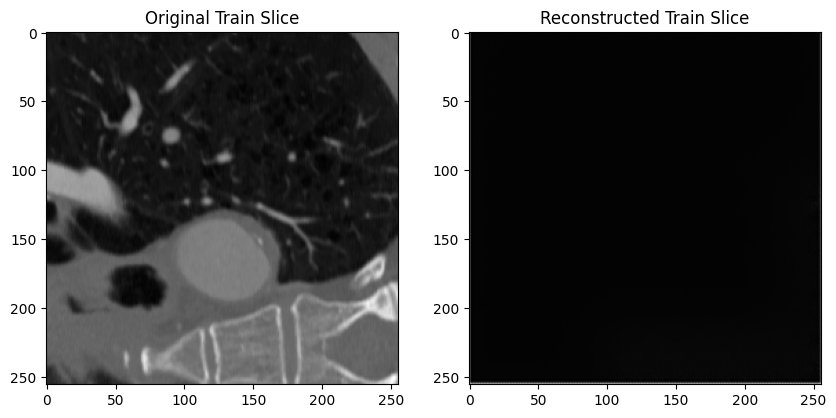

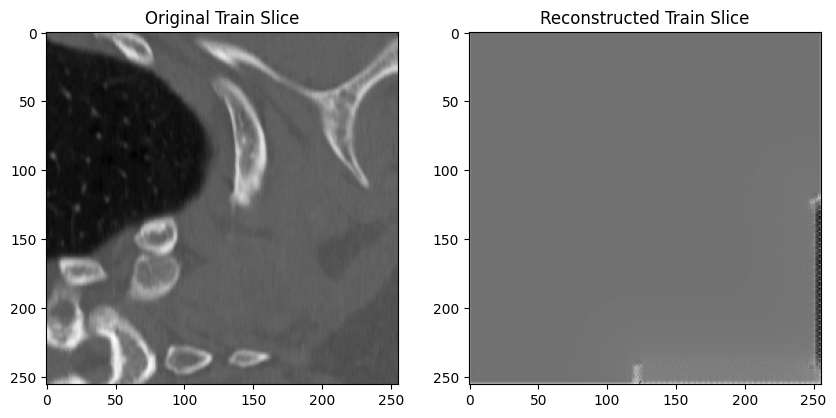

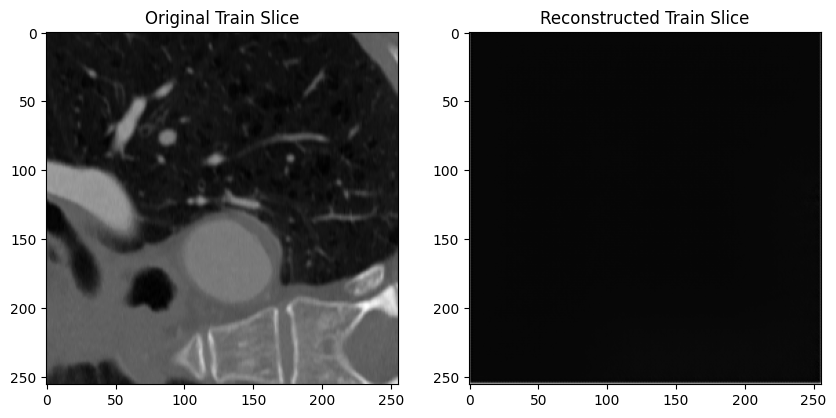

Validation: |          | 0/? [00:00<?, ?it/s]

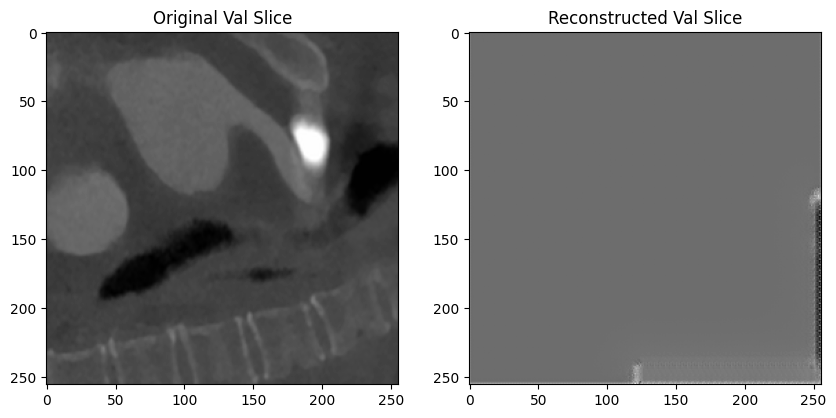

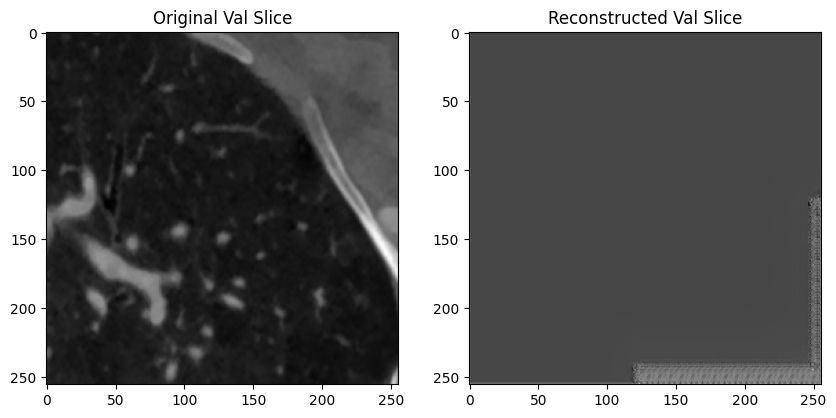

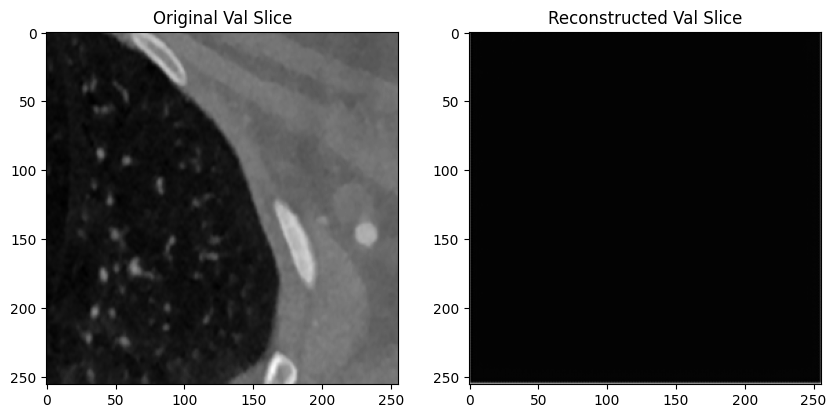

Time Spent 18661.42
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18719.48
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18782.16
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18867.03
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18972.09
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19032.84
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19096.10
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19158.57
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19216.73
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19277.38
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19338.53
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19400.96
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19459.11
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19517.37
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19575.51
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19636.76
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19700.37
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19762.82
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19823.20
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19884.46
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19942.62
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20003.23
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20067.49
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20129.49
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20192.42
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20254.58
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20312.62
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20370.99
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20433.98
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20497.46
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20555.53
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20613.85
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20674.60
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20732.75
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20793.01
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20851.06
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20909.28
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20967.49
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21025.70
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21083.85
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21141.88
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21199.97
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21258.03
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21316.11
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21374.29
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21432.33
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21490.47
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21548.54
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21606.57
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21665.29
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21723.38
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21781.57
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21839.67
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21897.74
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21956.24
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22014.36
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22072.48
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22130.57
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22188.76
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22246.88
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22305.16
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22363.78
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22421.83
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22479.95
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22538.06
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22596.26
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22654.57
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22713.42
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22771.58
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22829.66
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22887.69
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22945.88
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23004.47
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23062.49
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23121.16
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23179.26
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23237.37
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23295.50
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23353.63
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23411.72
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23469.87
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23527.93
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23586.27
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23644.42
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23702.46
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23760.72
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23818.80
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23876.86
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23934.95
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23993.21
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24051.46
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24109.58
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24167.64
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24225.73
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24283.87
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24341.98
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24400.03
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24458.21
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24516.24
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24575.12
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24634.23
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24692.37
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24750.46
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24809.09
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24867.16
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24925.22
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24983.47
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25041.80
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25100.01
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25158.25
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25216.49
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25274.91
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25332.98
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25391.12
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25449.35
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25507.48
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25566.17
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25624.22
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25682.43
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25740.71
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25799.34
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25857.52
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25915.57
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25973.66
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26032.36
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26090.48
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26148.54
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26206.69
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26265.03
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26323.13
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26381.41
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26439.73
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26497.87
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26555.99
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26614.70
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26672.75
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26731.06
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26789.97
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26848.10
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26906.37
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26964.50
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27022.58
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27081.07
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27139.26
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27197.36
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27255.52
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27313.69
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27371.75
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27429.82
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27488.52
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27546.66
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27604.89
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27663.14
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27721.35
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27779.38
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27837.51
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27895.60
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27953.66
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28011.73
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28069.86
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28128.11
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28186.40
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28244.55
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28302.68
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28360.73
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28418.87
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28477.00
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28535.43
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28594.22
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28652.24
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28710.45
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28768.68
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28826.88
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28885.08
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28943.67
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29001.93
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29059.96
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29118.18
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29176.49
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29234.64
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29292.86
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29350.98
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29409.06
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29467.21
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29525.34
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29583.41
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29641.73
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29699.84
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29758.01
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29816.07
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29874.18
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29932.57
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29990.69
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30048.93
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30107.09
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30165.18
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30223.41
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30281.58
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30339.74
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30398.53
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30456.60
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30514.86
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30573.09
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30631.24
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30689.49
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30747.64
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30805.73
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30864.14
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30922.35
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30980.47
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31038.58
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31096.81
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31154.93
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31213.09
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31271.23
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31329.46
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31387.57
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31445.68
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31503.77
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31562.88
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31621.00
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31679.13
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31737.47
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31796.06
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31854.88
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31912.93
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31971.17
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32030.57
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32090.27
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32148.39
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32206.60
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32264.95
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32323.00
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32381.33
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32439.76
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32498.04
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32556.20
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32614.58
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32672.76
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32731.06
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32789.26
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32847.43
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32905.49
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32963.66
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33021.71
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33079.82
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33138.06
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33196.15
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33254.23
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33313.05
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33372.56
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33430.84
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33488.99
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33547.74
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33605.86
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33664.02
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33722.21
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33780.51
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33838.64
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33896.81
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33955.08
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34013.32
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34071.45
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34129.67
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34187.86
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34246.22
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34304.29
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34362.36
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34420.42
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34478.54
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34536.64
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34594.77
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34652.98
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34711.77
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34770.40
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34828.58
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34886.70
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34944.80
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35002.98
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35061.10
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35119.21
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35177.82
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35235.98
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35294.41
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35352.88
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35411.01
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35469.17
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35527.36
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35585.51
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35643.74
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35702.39
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35761.10
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35819.16
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35877.35
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35935.46
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35993.84
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36052.15
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36110.31
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36168.53
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36227.11
Epoch: 600


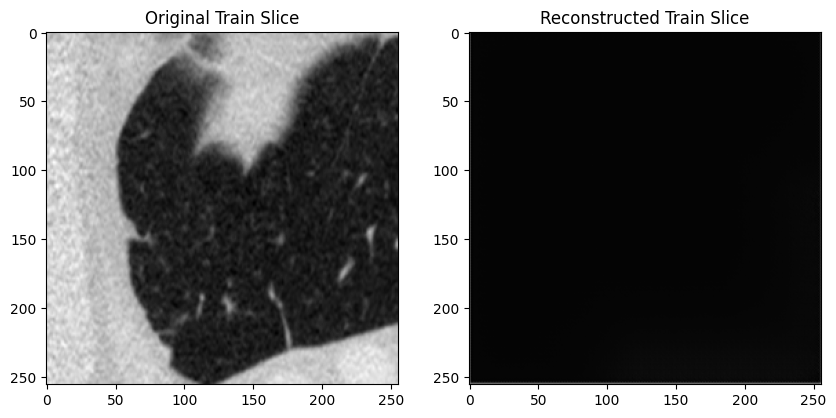

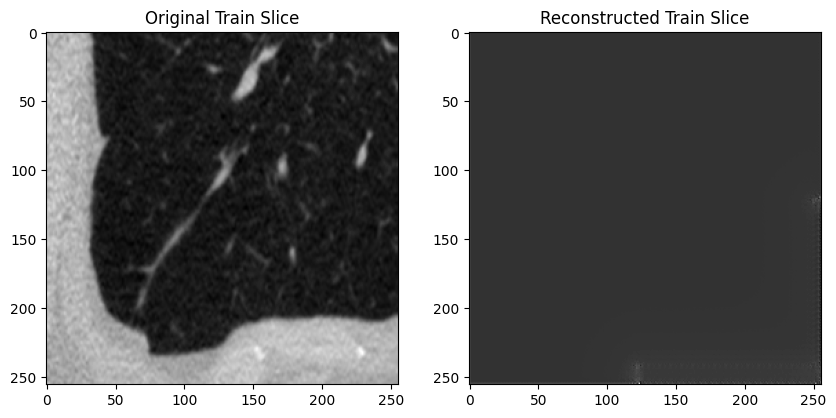

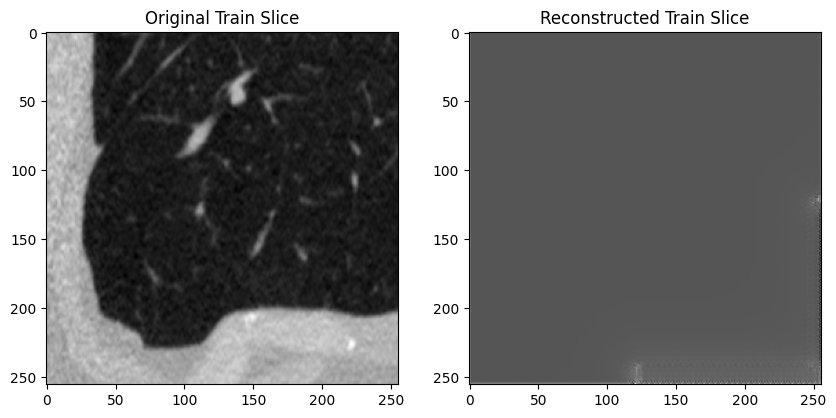

Validation: |          | 0/? [00:00<?, ?it/s]

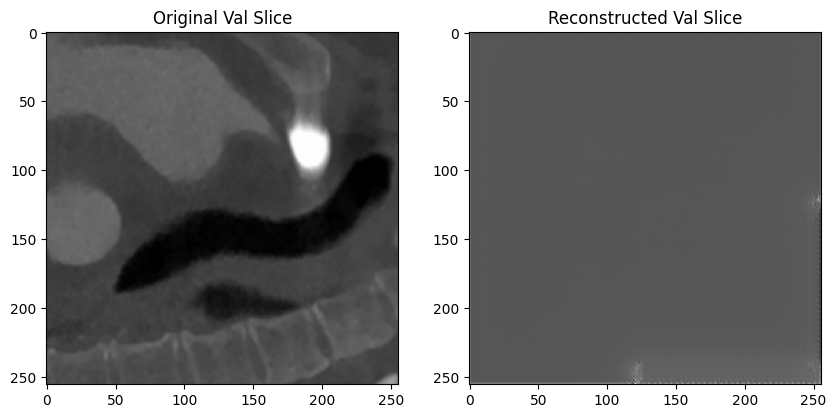

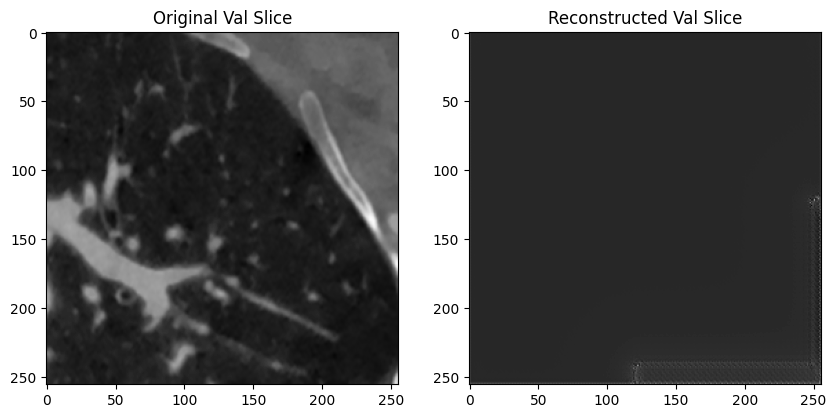

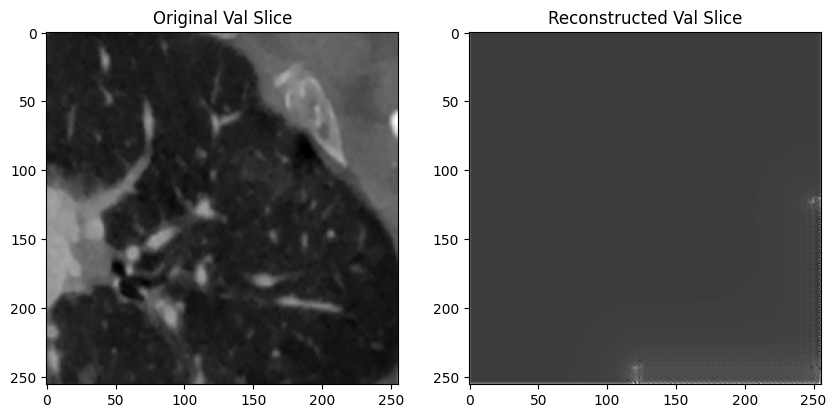

Time Spent 36288.44
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36346.79
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36404.90
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36463.05
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36521.27
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36579.42
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36637.55
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36696.25
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36754.42
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36812.56
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36871.01
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36929.13
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36987.25
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37045.60
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37104.69
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37162.83
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37221.06
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37279.17
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37337.43
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37395.52
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37453.65
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37512.07
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37570.16
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37628.23
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37686.92
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37745.11
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37803.21
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37861.47
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37919.70
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37977.89
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38035.99
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38094.53
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38152.68
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38210.80
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38268.98
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38327.22
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38385.39
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38443.67
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38501.84
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38560.05
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38618.12
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38676.34
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38734.56
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38792.65
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38850.78
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38909.07
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38967.23
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39025.44
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39083.78
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39142.56
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39200.65
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39258.81
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39317.26
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39375.37
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39433.67
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39491.85
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39549.99
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39608.68
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39666.83
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39724.99
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39783.18
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39841.42
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39899.64
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39957.83
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40016.00
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40074.11
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40132.39
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40190.54
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40248.71
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40306.79
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40365.14
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40423.32
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40481.52
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40539.88
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40598.63
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40656.73
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40715.40
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40773.55
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40831.68
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40889.90
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40948.04
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41007.94
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41066.07
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41124.26
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41182.39
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41240.59
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41298.80
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41357.00
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41415.22
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41473.38
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41531.59
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41589.79
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41648.03
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41706.33
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41764.52
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41822.88
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41882.95
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41941.19
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42000.50
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42059.22
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42117.40
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42176.66
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42234.76
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42292.84
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42351.10
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42409.33
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42467.53
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42525.75
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42583.99
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42642.12
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42700.29
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42758.38
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42816.58
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42874.80
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42932.90
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42991.02
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43049.10
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43107.36
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43165.50
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43223.96
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43282.09
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43340.17
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43398.39
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43456.50
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43515.32
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43573.53
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43631.64
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43689.79
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43747.89
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43805.97
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43864.09
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43922.25
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43980.43
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44038.59
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44096.83
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44155.13
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44213.28
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44271.54
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44329.65
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44387.92
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44446.03
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44504.14
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44562.29
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44620.43
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44678.60
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44736.67
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44794.80
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44853.04
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44911.18
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44970.01
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45028.20
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45086.33
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45144.47
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45202.64
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45260.70
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45318.94
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45377.10
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45435.28
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45493.40
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45551.55
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45609.75
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45667.88
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45726.13
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45784.31
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45842.40
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45900.52
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45958.77
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46017.07
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46075.19
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46133.42
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46191.65
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46249.85
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46307.99
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46366.81
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46425.52
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46483.68
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46541.85
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46600.06
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46658.16
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46716.48
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46774.59
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46832.71
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46890.81
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46948.98
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47007.17
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47065.30
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47123.64
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47181.82
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47239.92
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47298.15
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47356.31
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47414.41
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47472.59
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47530.71
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47588.96
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47647.12
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47705.32
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47763.48
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47821.65
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47880.49
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47939.64
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47997.91
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48056.33
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48114.48
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48172.64
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48231.03
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48289.44
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48347.61
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48406.01
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48464.25
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48522.45
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48580.61
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48638.81
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48696.95
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48755.14
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48813.33
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48871.45
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48929.62
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48987.75
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49045.93
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49104.10
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49162.42
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49220.62
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49278.90
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49338.01
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49396.24
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49454.50
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49512.73
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49570.93
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49629.07
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49687.34
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49745.42
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49803.59
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49861.72
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49919.83
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49977.94
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50036.22
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50094.40
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50152.54
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50210.79
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50268.97
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50327.32
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50385.57
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50443.70
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50501.93
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50560.16
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50618.33
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50676.47
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50734.72
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50793.38
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50851.58
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50909.74
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50968.03
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51026.18
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51084.40
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51142.50
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51200.64
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51258.75
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51317.09
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51375.23
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51433.48
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51491.62
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51549.83
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51607.98
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51666.13
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51724.29
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51782.40
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51840.51
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51898.66
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51956.82
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52014.96
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52073.09
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52131.21
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52189.32
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52248.18
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52306.34
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52364.81
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52422.90
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52481.19
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52539.40
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52597.61
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52655.87
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52714.08
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52772.54
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52830.76
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52889.01
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52947.24
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53005.43
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53063.60
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53121.74
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53179.92
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53238.11
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53296.17
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53354.62
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53412.76
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53470.93
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53529.04
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53587.26
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53645.60
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53704.29
Epoch: 900


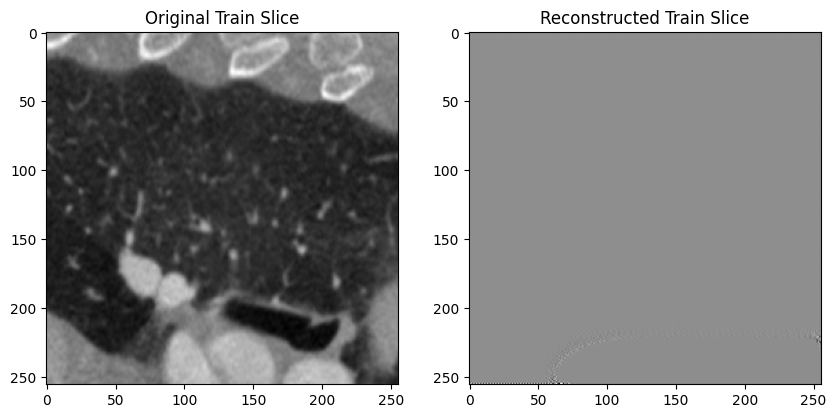

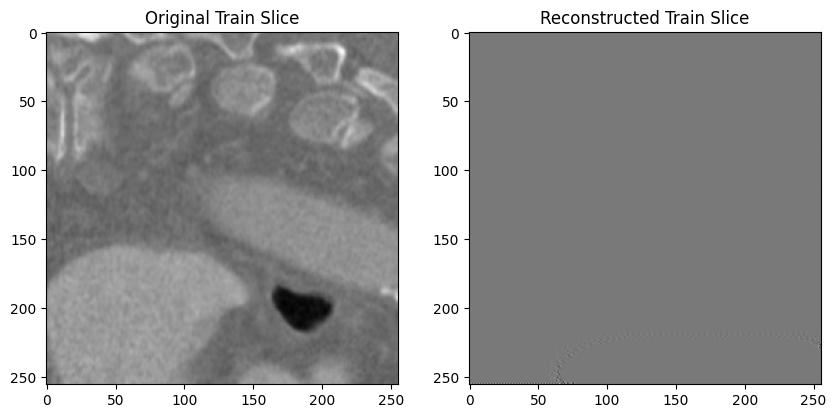

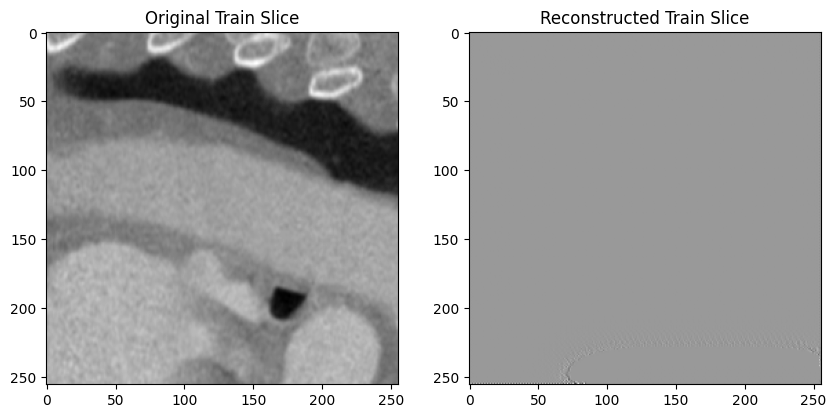

Validation: |          | 0/? [00:00<?, ?it/s]

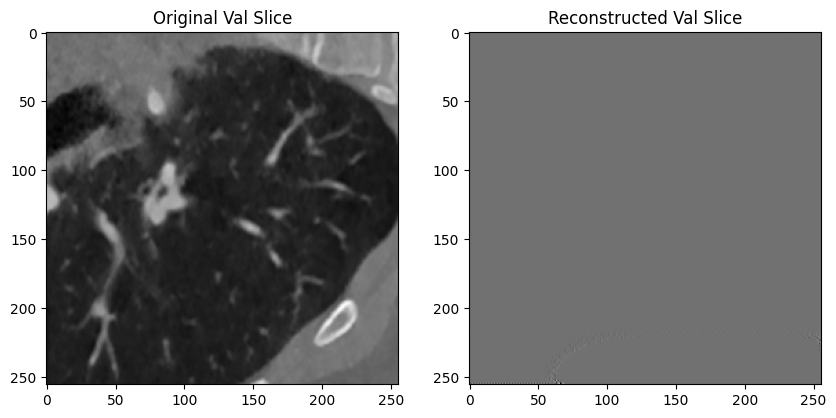

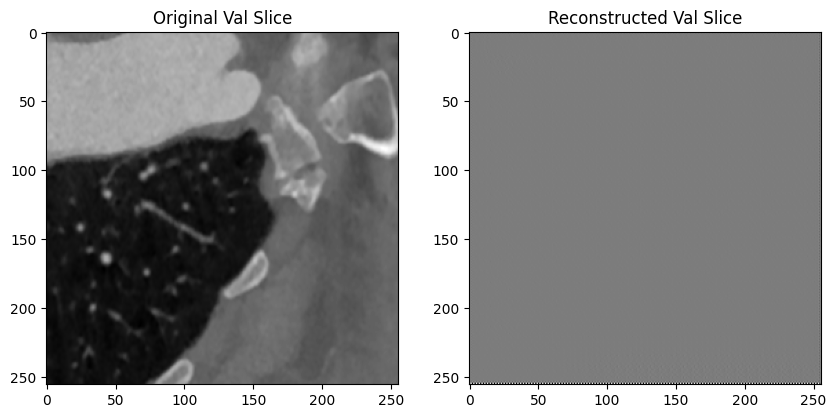

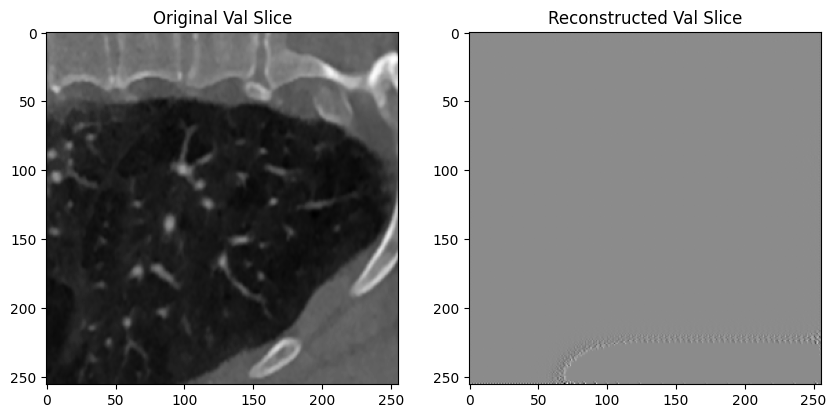

Time Spent 53765.07
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53823.27
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53881.52
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53939.71
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53997.84
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54056.02
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54114.13
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54172.24
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54230.45
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54288.57
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54346.79
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54404.93
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54463.10
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54521.25
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54579.41
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54637.52
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54695.67
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54753.83
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54812.09
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54870.27
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54928.54
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54986.68
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55044.93
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55103.52
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55162.21
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55220.39
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55278.53
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55336.67
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55394.85
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55453.03
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55511.27
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55569.46
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55627.57
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55685.87
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55744.02
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55802.31
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55860.42
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55918.56
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55976.70
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56035.02
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56093.24
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56151.45
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56209.67
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56267.79
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56326.00
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56384.30
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56442.46
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56500.65
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56558.82
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56617.73
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56675.95
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56734.13
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56792.37
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56850.47
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56908.58
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56966.73
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57024.92
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57083.04
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57141.28
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57199.53
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57257.78
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57315.93
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57374.14
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57432.20
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57490.33
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57548.50
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57606.62
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57664.78
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57722.94
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57781.38
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57839.52
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57897.65
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57955.86
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58014.03
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58072.81
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58131.06
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58189.22
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58247.39
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58305.56
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58363.72
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58421.88
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58481.22
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58539.41
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58597.54
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58655.74
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58713.93
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58772.14
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58830.22
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58888.36
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58946.52
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59004.67
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59062.83
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59121.06
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59179.49
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59237.67
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59295.95
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59354.14
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59412.35
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59470.47
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59529.19
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59588.37
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59646.58
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59704.75
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59763.06
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59821.34
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59879.48
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59937.62
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59995.93
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60054.13
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60112.31
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60170.45
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60228.68
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60286.93
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60345.09
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60403.24
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60461.43
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60519.57
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60577.69
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60635.81
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60694.06
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60752.26
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60810.45
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60868.66
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60926.82
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60985.48
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61043.58
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61101.75
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61159.92
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61218.23
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61276.55
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61334.75
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61392.94
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61451.11
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61509.43
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61567.61
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61625.78
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61684.01
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61742.24
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61800.40
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61858.61
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61917.03
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61975.22
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62033.34
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62091.47
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62149.60
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62207.92
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62266.13
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62324.62
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62384.74
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62443.50
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62501.70
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62559.88
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62618.14
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62676.33
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62734.48
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62792.60
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62850.81
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62908.95
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62967.36
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63025.57
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63083.69
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63141.95
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63200.11
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63258.41
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63316.59
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63374.73
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63433.04
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63491.27
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63549.56
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63607.75
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63666.00
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63724.30
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63782.92
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63841.14
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63899.83
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63957.97
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64016.34
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64074.59
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64132.74
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64191.02
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64249.24
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64307.51
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64365.70
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64424.68
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64482.89
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64541.17
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64599.36
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64657.69
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64715.83
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64774.37
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64832.54
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64890.72
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64948.89
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65007.05
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65065.24
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65123.39
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65181.53
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65240.39
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65298.55
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65357.38
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65415.60
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65473.85
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65532.06
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65590.24
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65648.39
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65711.95
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65774.10
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65835.61
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65893.85
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65952.02
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66010.27
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66068.65
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66126.88
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66185.45
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66243.65
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66301.94
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66360.16
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66418.49
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66476.77
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66535.25
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66593.67
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66651.92
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66710.22
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66768.42
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66827.38
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66885.69
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66943.95
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67002.17
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67060.36
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67118.63
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67176.85
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67237.86
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67296.04
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67354.37
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67412.52
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67470.64
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67528.86
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67587.13
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67645.30
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67703.48
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67761.64
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67819.84
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67878.04
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67936.18
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67994.34
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68052.55
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68110.79
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68169.03
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68227.22
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68285.92
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68344.18
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68402.37
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68460.57
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68518.74
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68577.03
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68635.29
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68693.46
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68751.62
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68810.37
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68868.56
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68926.73
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68984.86
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69043.05
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69101.53
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69159.78
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69218.02
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69276.30
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69334.45
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69392.63
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69450.80
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69510.85
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69568.97
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69627.23
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69685.41
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69744.26
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69802.52
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69860.71
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69918.98
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69977.16
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70035.46
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70093.95
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70152.13
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70210.26
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70268.65
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70326.83
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70385.65
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70443.77
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70501.99
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70560.13
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70618.37
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70676.58
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70734.74
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70792.88
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70851.02
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70909.23
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70967.51
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71025.66
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71083.91
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71142.27
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71201.07
Epoch: 1200


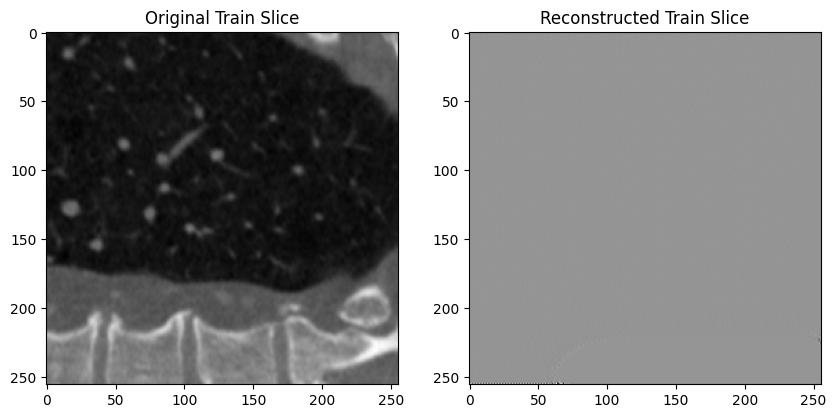

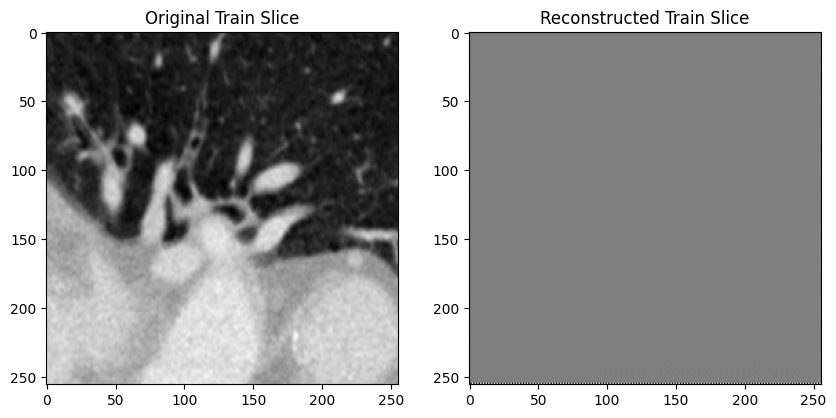

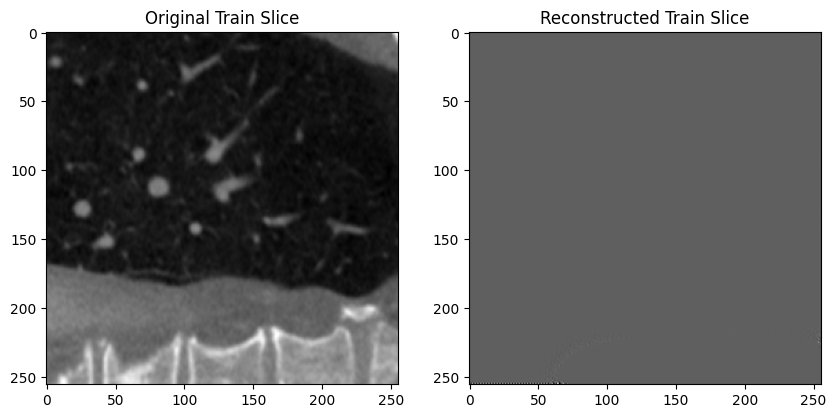

Validation: |          | 0/? [00:00<?, ?it/s]

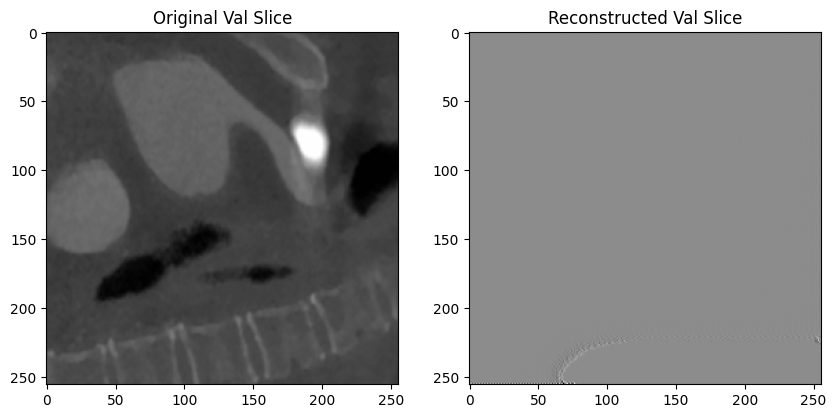

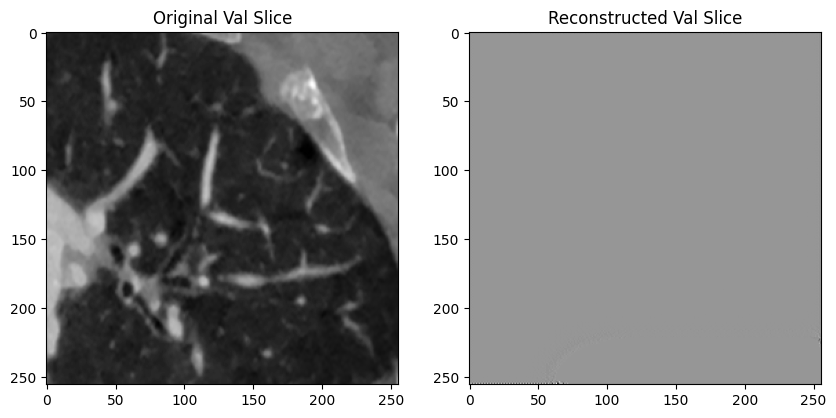

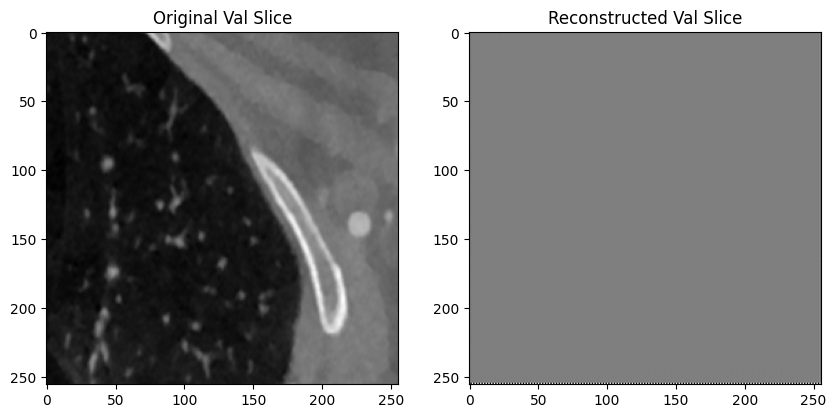

Time Spent 71262.43
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71320.65
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71378.82
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71436.99
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71495.20
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71553.45
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71611.61
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71669.80
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71728.26
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71786.47
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71844.68
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71903.08
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71961.27
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72019.56
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72077.74
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72138.20
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72200.56
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72258.78
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72317.15
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72375.53
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72433.78
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72491.98
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72550.17
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72608.40
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72667.25
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72725.49
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72783.72
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72841.91
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72900.19
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72958.58
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73016.90
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73075.07
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73133.36
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73191.64
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73249.82
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73308.09
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73366.25
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73424.51
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73482.80
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73541.15
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73599.43
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73657.73
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73715.97
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73774.14
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73832.45
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73890.66
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73948.85
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74007.04
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74065.25
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74123.95
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74182.22
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74240.58
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74298.77
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74357.00
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74415.25
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74473.47
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74531.65
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74589.85
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74648.02
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74706.19
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74764.43
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74822.67
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74880.85
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74939.09
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74997.25
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75055.47
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75113.78
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75172.01
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75230.28
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75288.57
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75346.93
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75405.22
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75463.40
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75521.67
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75580.52
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75638.78
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75696.99
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75755.22
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75813.45
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75871.90
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75930.06
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75988.35
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76046.76
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76104.97
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76163.16
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76221.47
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76280.51
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76338.85
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76397.14
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76455.69
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76514.05
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76572.48
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76630.63
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76688.84
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76747.08
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76805.25
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76863.39
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76921.57
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76979.96
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77038.80
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77097.13
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77155.33
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77213.54
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77271.68
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77329.98
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77388.90
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77447.13
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77505.27
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77563.41
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77621.60
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77679.74
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77737.95
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77796.22
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77854.50
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77912.66
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77970.82
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78029.16
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78087.30
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78145.57
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78203.78
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78261.94
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78320.16
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78378.53
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78436.73
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78495.83
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78554.27
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78615.37
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78676.57
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78734.71
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78792.93
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78851.23
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78909.68
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78968.03
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79026.36
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79084.60
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79142.99
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79201.18
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79259.59
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79317.96
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79376.28
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79434.52
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79492.73
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79551.09
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79609.56
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79667.81
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79726.02
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79784.33
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79842.60
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79900.85
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79959.54
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80017.76
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80075.93
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80134.15
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80192.67
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80250.84
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80311.40
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80370.10
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80428.45
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80486.76
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80544.96
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80603.23
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80661.44
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80719.82
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80777.94
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80836.53
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80894.88
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80953.07
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81011.28
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81069.57
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81127.95
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81186.15
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81244.40
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81302.68
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81360.84
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81420.02
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81478.23
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81536.40
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81594.67
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81653.27
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81711.52
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81769.73
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81828.05
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81886.19
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81944.36
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82002.57
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82061.13
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82119.43
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82177.77
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82235.96
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82294.15
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82352.38
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82410.60
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82468.85
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82527.17
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82585.57
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82644.08
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82702.64
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82760.90
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82819.25
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82879.58
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82938.96
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82997.27
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83055.46
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83113.65
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83171.85
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83230.15
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83288.35
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83346.53
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83404.75
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83463.77
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83522.11
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83582.51
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83640.90
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83699.30
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83757.56
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83816.35
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83875.49
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83933.86
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83992.23
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84050.58
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84108.74
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84167.09
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84225.30
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84283.92
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84343.00
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84401.40
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84459.50
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84517.85
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84576.03
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84634.15
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84693.46
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84751.72
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84809.96
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84868.11
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84926.41
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84984.62
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85042.92
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85101.40
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85159.61
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85217.74
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85276.12
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85334.25
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85393.29
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85456.59
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85514.70
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85572.86
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85631.24
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85690.09
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85748.33
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85807.12
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85865.39
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85923.43
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85982.59
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86041.16
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86103.64
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86161.98
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86220.63
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86278.95
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86337.28
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86395.70
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86454.14
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86513.06
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86571.56
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86629.86
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86688.19
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86746.57
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86805.24
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86863.57
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86921.82
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86980.19
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87038.78
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87097.30
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87155.70
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87214.92
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87273.76
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87332.26
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87390.60
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87449.02
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87507.75
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87565.95
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87624.49
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87682.62
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87741.08
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87799.39
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87858.49
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87916.75
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87975.29
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88033.57
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88092.15
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88150.32
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88208.87
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88268.21
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88327.80
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88386.17
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88444.35
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88503.08
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88561.36
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88619.58
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88677.89
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88736.86
Epoch: 1500


`Trainer.fit` stopped: `max_epochs=1500` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1386133      

In [3]:
# Initialize model and start training
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')